In [29]:
# Imports and hyperparams
%matplotlib inline
import os
import numpy as np
import scipy.io as sio
import scipy.signal as signal
from DenseDepthModel import DenseDepth
from models.data.data_utils.sid_utils import SID
from remove_dc_from_spad import remove_dc_from_spad_edge
from weighted_histogram_matching import image_histogram_match
# from spad_utils import rescale_bins
import h5py
import matplotlib.pyplot as plt
rootdir = "data/8_29_Kitchen_Video2"

os.environ["CUDA_VISIBLE_DEVICES"] = "3"

def loadmat_h5py(file):
    output = {}
    with h5py.File(file, 'r') as f:
        for k, v in f.items():
            output[k] = np.array(v)
    return output

def z_to_r_kinect(z):
    fc = [1053.622, 1047.508]  # Focal length in pixels
    yy, xx = np.meshgrid(range(z.shape[0]), range(z.shape[1]), indexing="ij")
    x = (xx * z) / fc[0]
    y = (yy * z) / fc[1]
    r = np.sqrt(x**2 + y**2 + z**2)
    return r

def r_to_z_kinect(r):
    fc = [1053.622, 1047.508]  # Focal length in pixels
    yy, xx = np.meshgrid(range(r.shape[0]), range(r.shape[1]), indexing="ij")
    z = r / np.sqrt((xx/fc[0])**2 + (yy/fc[1])**2 + 1)
    return z

In [2]:
# Calibration data
print("Loading calibration data...")
calib = loadmat_h5py(os.path.join(rootdir, "calibration.mat"))


Loading calibration data...


In [3]:
# Load SPAD data
# Extract relevant subset of SPAD and save
bin_width_ps = 16  # Bin width is 16 ps
bin_width_m = bin_width_ps*3e8/(2*1e12)
min_depth = 0.6  # Reject internal reflections
min_depth_bin = int(min_depth/bin_width_m)
max_depth = 6.
max_depth_bin = int(max_depth/bin_width_m)
print("min depth, max_depth")
print(min_depth, max_depth)
print(min_depth_bin, max_depth_bin)

# Ambient data
# print("Loading ambient data...")
# spad_ambient = loadmat_h5py(os.path.join(rootdir, "ambient", "data_accum.mat"))
# ambient_relevant = spad_ambient["mat"][..., min_depth_bin:max_depth_bin]
# np.save(os.path.join(rootdir, "ambient_relevant.npy"), ambient_relevant)
# ambient_relevant = np.load(os.path.join(rootdir, "ambient_relevant.npy"))




min depth, max_depth
0.6 6.0
250 2500
Loading ambient data...


In [4]:
# SPAD data
print("Loading SPAD data...")
n_frames = 98
# spad_frames = np.zeros((64, 64, 4096, n_frames))
# for i in range(n_frames):
#     spad = loadmat_h5py(os.path.join(rootdir, "frame_{}.mat".format(i)))
#     spad_frames[...,i] = spad["frame"]
#     # Note: No flipping or realignment needed
# spad_frames_relevant = spad_frames[..., min_depth_bin:max_depth_bin, :]
# np.save(os.path.join(rootdir, "spad_frames.npy"), spad_frames_relevant)
spad_frames_relevant = np.load(os.path.join(rootdir, "spad_frames.npy"))



Loading SPAD data...


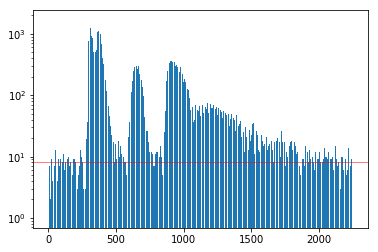

In [10]:
hist = np.sum(spad_frames_relevant[...,1], axis=(0, 1))
plt.bar(range(len(hist)), hist, log=True)
ambient_estimate = np.mean(np.sum(spad_frames_relevant[..., 2000:, :], axis=(0,1)))
plt.axhline(y=ambient_estimate, color='r', linewidth=0.5)

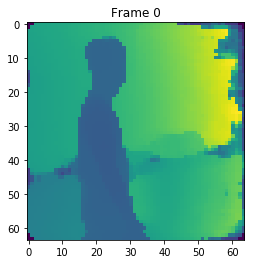

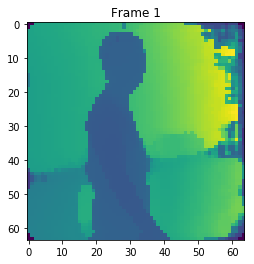

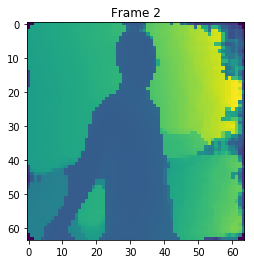

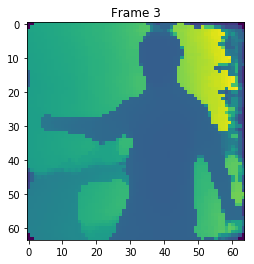

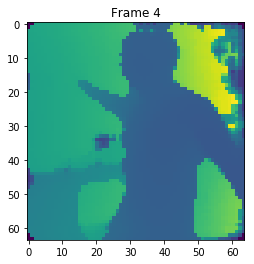

...

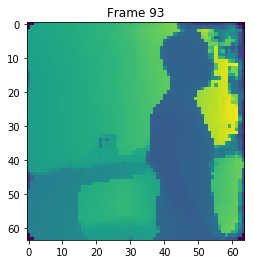

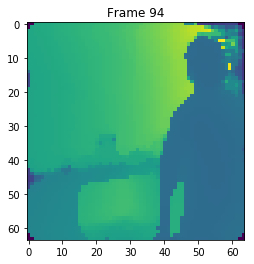

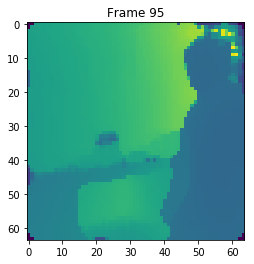

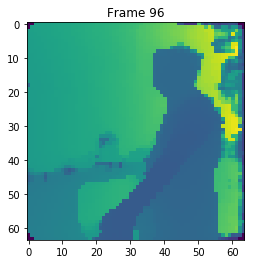

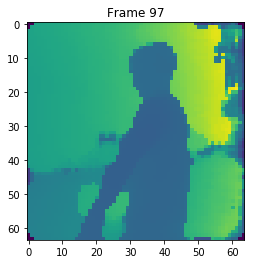

In [11]:
# spad['frame']
n_frames = 98
for i in range(n_frames):
    gt_idx = np.argmax(spad_frames_relevant[...,i], axis=2)
    gt_r = signal.medfilt(np.fliplr(np.flipud(((gt_idx + min_depth_bin) * bin_width_m).T)), kernel_size=5)
    plt.imshow(gt_r)
    plt.title("Frame {}".format(i))
    plt.draw()
    plt.pause(0.1)
    
framestart = 60
frameend = 98

(-0.5, 511.5, 511.5, -0.5)

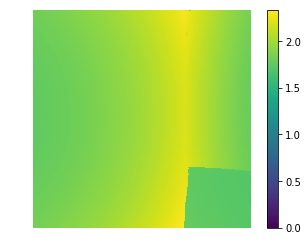

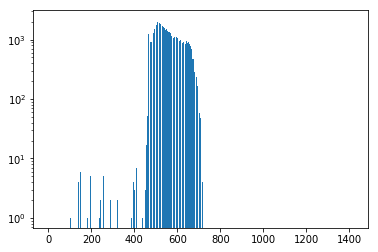

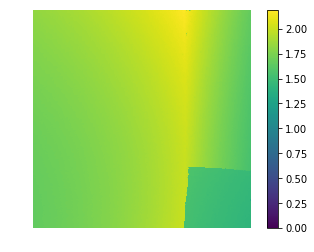

In [4]:
# Get Ground truth depth
import scipy.signal as signal
gt_idx = np.argmax(spad_relevant, axis=2)
gt_r = signal.medfilt(np.fliplr(np.flipud(((gt_idx + min_depth_bin) * bin_width_m).T)), kernel_size=5)
plt.figure()
plt.imshow(gt_r)
plt.colorbar()
plt.axis('off')

gt_r_hist, _ = np.histogram(gt_r, range=(min_depth, max_depth), bins=spad_relevant.shape[2])
plt.figure()
plt.bar(range(len(gt_r_hist)), gt_r_hist, log=True)

gt_z = r_to_z_kinect(gt_r)
plt.figure()
plt.imshow(gt_z)
plt.colorbar()
plt.axis("off")

In [12]:
# Kinect data
print("Loading kinect data...")
kinect = loadmat_h5py(os.path.join(rootdir, "kinect_video.mat"))

Loading kinect data...


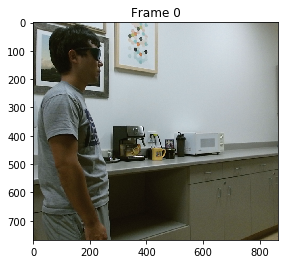

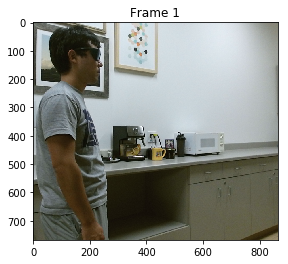

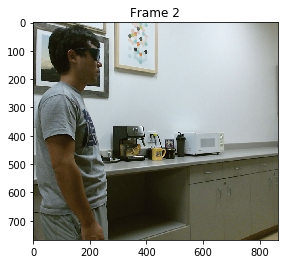

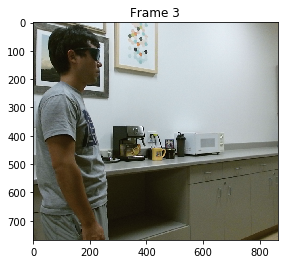

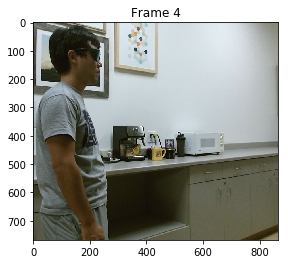

...

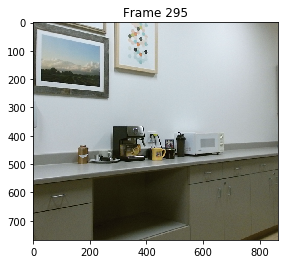

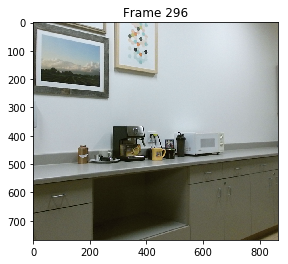

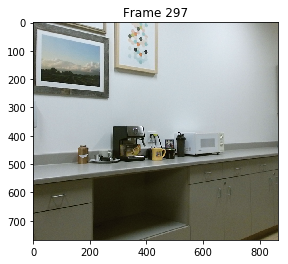

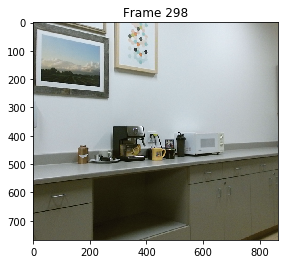

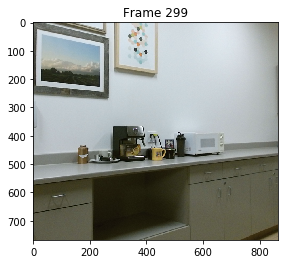

In [27]:
n_rgb_frames = kinect["imgColor"].shape[0]
for i in range(n_rgb_frames):
    kinect_rgb = np.fliplr(kinect["imgColor"][i,...].transpose(2, 1, 0))/255.
    kinect_rgb_cropped = kinect_rgb[crop[0]:crop[1], crop[2]:crop[3], :]
    plt.imshow(kinect_rgb_cropped)
    plt.title("Frame {}".format(i))
    plt.draw()
    plt.pause(0.1)

0
0


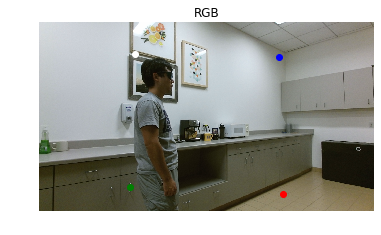

In [25]:
# Kinect data

# Transpose and visualize
plt.figure()
kinect_rgb = np.fliplr(kinect["imgColor"][0,...].transpose(2, 1, 0))/255.
plt.imshow(kinect_rgb)
plt.title("RGB")
plt.axis("off")
plt.plot(calib["pos_00"][1], calib["pos_00"][0], "ro")
plt.plot(calib["pos_01"][1], calib["pos_01"][0], "bo")
plt.plot(calib["pos_10"][1], calib["pos_10"][0], "go")
plt.plot(calib["pos_11"][1], calib["pos_11"][0], "wo")

# print(calib["pos_00"]) # position 0 is the row, position 1 is the column
# Extract crop
top = (calib["pos_01"][0] + calib["pos_11"][0])//2
bot = (calib["pos_10"][0] + calib["pos_00"][0])//2
left = (calib["pos_11"][1] + calib["pos_10"][1])//2
right = (calib["pos_01"][1] + calib["pos_00"][1])//2
# Correct so that side lengths work out
crop = (int(top[0])+3, int(bot[0])-2, int(left[0])-7, int(right[0])+6)
print((crop[1] - crop[0]) % 32)
print((crop[3] - crop[2]) % 32)

# plt.figure()
# kinect_depth = np.fliplr(kinect["depth_im"].transpose(1, 0))
# plt.imshow(kinect_depth)
# plt.title("Kinect Depth")
# plt.axis("off");

In [6]:
# Load camera intrinsics
# From https://link.springer.com/chapter/10.1007/978-3-662-47487-7_17
fc = [1053.622, 1047.508]  # Focal length in pixels
cc = [950.3941, 527.3442]  # Principal point
s = 0.                     # Skew

# Adjust principal point using crop
cc[0] -= crop[2]
cc[1] -= crop[0]

print(cc)

[446.3941, 389.3442]


Instructions for updating:
Colocations handled automatically by placer.


/home/markn1/anaconda3/envs/depth-net/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '



Existing model loaded.

Model created.


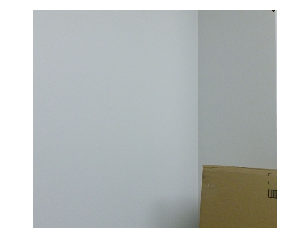

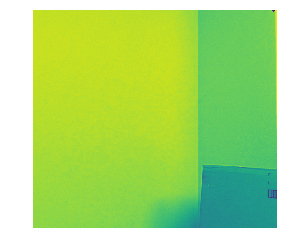

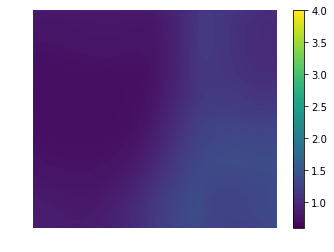

In [7]:
# Crop and run RGB through network
rgb_cropped = kinect_rgb[crop[0]:crop[1], crop[2]:crop[3], :]
plt.imshow(rgb_cropped)
plt.axis("off")

# Extract intensity
intensity = rgb_cropped[:,:,0]
plt.figure()
plt.imshow(intensity)
plt.axis("off")
weights = intensity/255.

# model = DenseDepth()
z_init = model.predict(rgb_cropped)[0,...]
plt.figure()
plt.imshow(z_init, vmin=min_depth, vmax=max_depth)
plt.axis("off")
plt.colorbar()


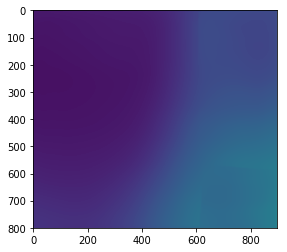

In [23]:
# Convert depth to radial distance using intrisics
r_init = z_to_r_kinect(z_init)
plt.imshow(r_init, vmin=min_depth, vmax=max_depth)


1416


<BarContainer object of 1416 artists>

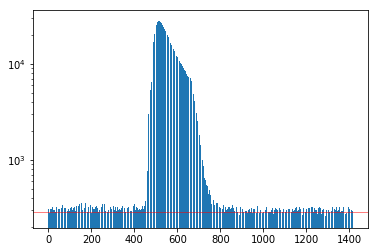

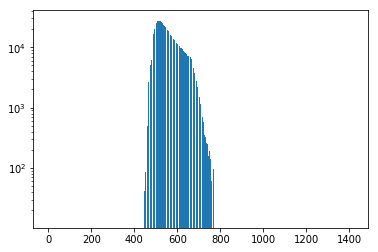

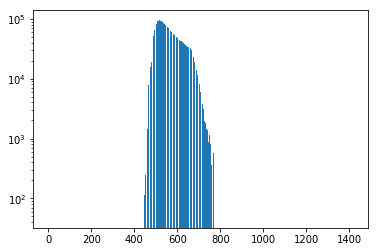

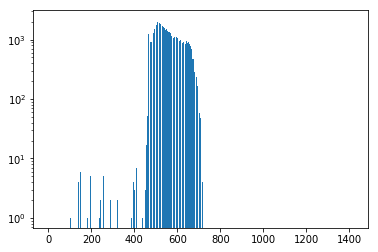

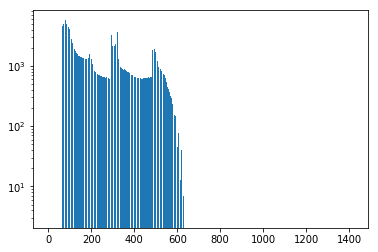

In [26]:
# Preprocess SPAD
sid_obj = SID(sid_bins=140, alpha=min_depth, beta=max_depth, offset=-min_depth/2)

spad_single = np.sum(spad_relevant, axis=(0,1))
plt.bar(range(len(spad_single)), spad_single, log=True)
print(len(spad_single))
# Estimate Ambient
ambient_estimate = np.mean(np.sum(ambient_relevant, axis=(0,1)))
plt.axhline(y=ambient_estimate, color='r', linewidth=0.5)

# Remove DC
spad_denoised = remove_dc_from_spad_edge(spad_single, ambient_estimate)
plt.figure()
plt.bar(range(len(spad_denoised)), spad_denoised, log=True)

# Correct Falloff
bin_edges = np.linspace(min_depth, max_depth, len(spad_denoised) + 1)
bin_values = (bin_edges[1:] + bin_edges[:-1])/2
spad_corrected = spad_denoised * bin_values ** 2
plt.figure()
plt.bar(range(len(spad_corrected)), spad_corrected, log=True)

# GT for comparison
gt_r_hist, _ = np.histogram(gt_r, range=(min_depth, max_depth), bins=spad_relevant.shape[2])
plt.figure()
plt.bar(range(len(gt_r_hist)), gt_r_hist, log=True)

# Initial Depth Histogram
r_init_hist, _ = np.histogram(r_init, range=(min_depth, max_depth), bins=spad_relevant.shape[2])
plt.figure()
plt.bar(range(len(r_init_hist)), r_init_hist, log=True)

In [10]:
def rescale_bins(spad_counts, min_depth, max_depth, sid_obj):
    """
    Works in Numpy
    :param spad_counts: The histogram of spad counts to rescale.
    :param min_depth: The minimum depth of the histogram.
    :param max_depth: The maximum depth of the histogram.
    :param sid_obj: An object representing a SID.
    :return: A rescaled histogram in time to be according to the SID

    Assign photons to sid bins proportionally according to the amount of overlap between
    the sid bin range and the spad_count bin.
    """

    sid_bin_edges_m = sid_obj.sid_bin_edges - sid_obj.offset
#     print(sid_bin_edges_m)
    # Convert sid_bin_edges_m into units of spad bins
    sid_bin_edges_bin = sid_bin_edges_m * len(spad_counts) / (max_depth - min_depth)
    sid_bin_edges_bin -= sid_bin_edges_bin[0]  # Start at 0
    sid_bin_edges_bin[-1] = np.floor(sid_bin_edges_bin[-1])
    # print(sid_bin_edges_bin[-1])
    # Map spad_counts onto sid_bin indices
    print(sid_bin_edges_bin)
    sid_counts = np.zeros(sid_obj.sid_bins)
    for i in range(sid_obj.sid_bins):
#         print(i)
        left = sid_bin_edges_bin[i]
        right = sid_bin_edges_bin[i + 1]
        curr = left
        while curr != right:
#             print(curr)
            curr = np.min([right, np.floor(left + 1.)])  # Don't go across spad bins - stop at integers
            sid_counts[i] += (curr - left) * spad_counts[int(np.floor(left))]
            # Update window
            left = curr

    return sid_counts

[   0.          2.262329    4.565613    6.910553    9.298035   11.728699
   14.203369   16.72284    19.287964   21.899506   24.55835    27.26538
   30.021393   32.8273     35.68399    38.59247    41.55356    44.568268
   47.637604   50.76248    53.94397    57.182983   60.480774   63.838196
   67.25641    70.73654    74.27969    77.88699    81.55957    85.29874
   89.10553    92.98126    96.927185  100.94455   105.0347    109.19888
  113.438446  117.75479   122.14929   126.62338   131.17847   135.81601
  140.53757   145.34457   150.23868   155.22131   160.29425   165.45905
  170.71729   176.0708    181.52118   187.07037   192.71991   198.47183
  204.32791   210.28992   216.35999   222.53995   228.83176   235.23755
  241.75934   248.3992    255.15924   262.04175   269.04892   276.18283
  283.446     290.84067   298.36923   306.0341    313.83786   321.7828
  329.87167   338.10696   346.49136   355.02756   363.7184    372.56662
  381.57492   390.74643   400.08408   409.59067   419.26944   

<BarContainer object of 140 artists>

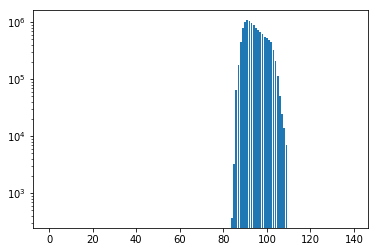

In [11]:
# Convert to SID
spad_sid = rescale_bins(spad_corrected, min_depth, max_depth, sid_obj)
plt.figure()
# plt.bar(range(len(spad_sid)), spad_sid)
plt.bar(range(len(spad_sid)), spad_sid, log=True)

/home/markn1/spad_single/models/data/data_utils/sid_utils.py:49: RuntimeWarning: invalid value encountered in log
  sid_index = np.floor(self.sid_bins * (np.log(arr + self.offset) - np.log(self.alpha_star)) /


<BarContainer object of 140 artists>

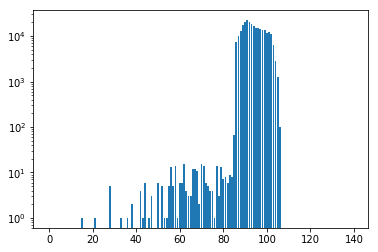

In [12]:
# Show non-SID gt histogram
# gt_hist, _ = np.histogram(gt, range=(min_depth, max_depth), bins=len(spad_denoised))

# Show gt histogram for reference
gt_r_idx = sid_obj.get_sid_index_from_value(gt_r)
gt_r_hist, _ = np.histogram(gt_r_idx, bins=range(sid_obj.sid_bins + 1))
plt.figure()
plt.bar(range(len(gt_r_hist)), gt_r_hist, log=True)

<BarContainer object of 140 artists>

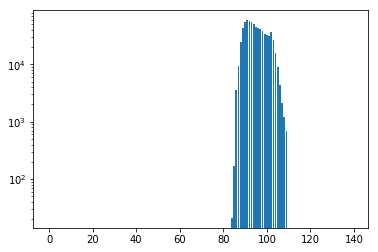

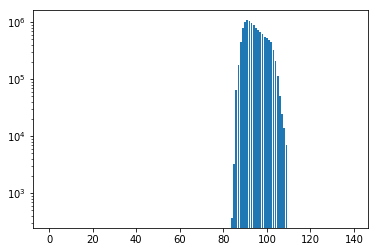

In [13]:
# Perform histogram matching
r_pred, _ = image_histogram_match(r_init, spad_sid, weights, sid_obj)
r_pred_idx = sid_obj.get_sid_index_from_value(r_pred)
r_pred_hist, _ = np.histogram(r_pred_idx, bins=range(sid_obj.sid_bins+1))
plt.figure()
plt.bar(range(len(r_pred_hist)), r_pred_hist, log=True)
plt.figure()
plt.bar(range(len(spad_sid)), spad_sid, log=True)

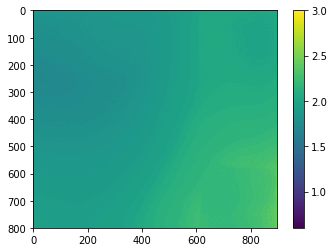

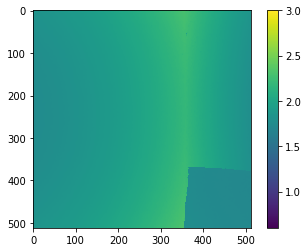

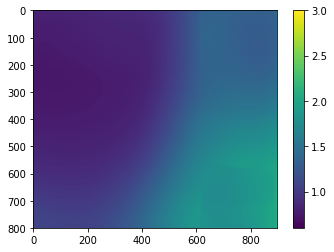

In [15]:
plt.figure()
plt.imshow(r_pred, vmin=min_depth, vmax=3.)
plt.colorbar()

plt.figure()
plt.imshow(gt_r, vmin=min_depth, vmax=3.)
plt.colorbar()

plt.figure()
plt.imshow(r_init, vmin=min_depth, vmax=3.)
plt.colorbar()

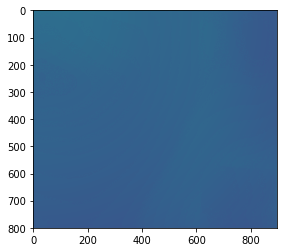

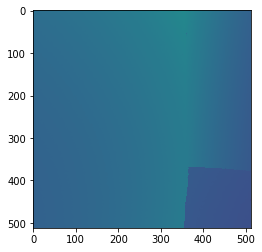

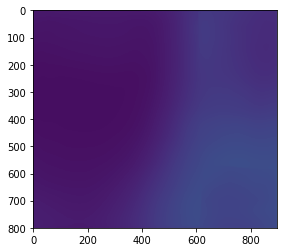

In [16]:
# Convert GT image to RGB-D, convert RGB-R output to RGB-D, compare
z_pred = r_to_z_kinect(r_pred)
gt_z = r_to_z_kinect(gt_r)
z_init = r_to_z_kinect(r_init)
plt.figure()
plt.imshow(z_pred, vmin=min_depth, vmax=max_depth)

plt.figure()
plt.imshow(gt_z, vmin=min_depth, vmax=max_depth)

plt.figure()
plt.imshow(z_init, vmin=min_depth, vmax=max_depth)



In [25]:
# Calculate metrics, plot results, generate figures
import torch
import cv2
from models.loss import get_depth_metrics
def pprint_metrics(metrics):
    print("{:>10}, {:>10}, {:>10}, {:>10}, {:>10}, {:>10}".format('d1', 'd2', 'd3', 'rel', 'rmse', 'log_10'))
    print(
        "{:10.4f}, {:10.4f}, {:10.4f}, {:10.4f}, {:10.4f}, {:10.4f}".format(metrics["delta1"],
                                                                            metrics["delta2"],
                                                                            metrics["delta3"],
                                                                            metrics["rel_abs_diff"],
                                                                            metrics["rmse"],
                                                                            metrics["log10"]))

    
gt_z[gt_z == 0] = 1e-3  # Clip to avoid numerical issues

z_pred_resized = cv2.resize(z_pred, gt_z.shape)
pred_metrics = get_depth_metrics(torch.from_numpy(z_pred_resized),
                  torch.from_numpy(gt_z),
                  torch.ones(z_pred_resized.shape))

z_init_resized = cv2.resize(z_init, gt_z.shape)
init_metrics = get_depth_metrics(torch.from_numpy(z_init_resized),
                  torch.from_numpy(gt_z),
                  torch.ones(z_init_resized.shape))

print("Before:")
pprint_metrics(init_metrics)

print("After:")
pprint_metrics(pred_metrics)

print("Standard Dev. of scene: {}".format(np.std(gt_z)))


Before:
        d1,         d2,         d3,        rel,       rmse,     log_10
    0.1022,     0.2287,     0.4704,     0.4999,     0.8770,     0.2750
After:
        d1,         d2,         d3,        rel,       rmse,     log_10
    0.9989,     0.9996,     0.9999,     0.1669,     0.1952,     0.0420
Standard Dev. of scene: 0.15032837080725026


In [24]:
np.sqrt(np.mean((gt_z - np.mean(gt_z))**2))

0.15032837080725026